In this project we are going to do plant health image classification. The overall goal is to buil a web app which is going to use the ML model built here in performing image classification. The dataset has been obtained from the following url: https://github.com/spMohanty/PlantVillage-Dataset 

We are going to use Google Colab for this project as it facilitates the usage of free GPU.

In [0]:
#commenting the below 2 lines as it contains information related to my Google account
#from google.colab import drive
#drive.mount('/content/drive')

In [2]:
import tensorflow as tf

In [0]:
tf.enable_eager_execution()

In [0]:
# if you don't have tensorflowjs package installed,please uncomment the below line
#!pip install tensorflowjs

In [0]:
import tensorflowjs as tfjs

In [6]:
from keras import layers, models, optimizers
from keras.preprocessing.image import ImageDataGenerator
from keras.applications import MobileNet
from keras.applications.mobilenet import preprocess_input

Using TensorFlow backend.


In [0]:
import zipfile
from zipfile import ZipFile
import pandas as pd
import numpy as np
import os, shutil
from math import ceil, floor
from IPython.display import display
from PIL import Image
import seaborn as sns

In [0]:
def unzip_files(zipFilePath, unzip_directory):
    zipFile = ZipFile(zipFilePath, 'r')
    zipFile.extractall(unzip_directory)
    zipFile.close()

In [0]:
unzip_files('drive/My Drive/datasets/plant_disease/plant_dataset_in_color.zip', 'Unzipped_plant_health_data')

In [10]:
os.listdir('Unzipped_plant_health_data')

['color']

In [11]:
os.listdir('Unzipped_plant_health_data/color')

['Strawberry___Leaf_scorch',
 'Apple___healthy',
 'Potato___Late_blight',
 'Apple___Black_rot',
 'Grape___Black_rot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Pepper,_bell___Bacterial_spot',
 'Soybean___healthy',
 'Corn_(maize)___Common_rust_',
 'Potato___Early_blight',
 'Peach___Bacterial_spot',
 'Grape___healthy',
 'Raspberry___healthy',
 'Pepper,_bell___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Grape___Esca_(Black_Measles)',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Bacterial_spot',
 'Squash___Powdery_mildew',
 'Blueberry___healthy',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___healthy',
 'Apple___Apple_scab',
 'Strawberry___healthy',
 'Apple___Cedar_apple_rust',
 'Cherry_(including_sour)___Powdery_mildew',
 'Tomato___Leaf_Mold',
 'Peach___healthy',
 'Potato___healthy',
 'Tomato___Late_blight',
 'Tomato___Target_Spot',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spo

from above we can see that the folders are a mixture of healthy and diseased plants of different fruits and vegetables. So, let us save these details in a list.

In [0]:
plant_health_categories = os.listdir('Unzipped_plant_health_data/color')
plant_health_categories.sort()

let us check the number of files in each category

In [13]:
for cur_health_category in plant_health_categories:
  print('current health category', cur_health_category)
  print('number of files', len(os.listdir('Unzipped_plant_health_data/color/' + cur_health_category)))

current health category Apple___Apple_scab
number of files 630
current health category Apple___Black_rot
number of files 621
current health category Apple___Cedar_apple_rust
number of files 275
current health category Apple___healthy
number of files 1645
current health category Blueberry___healthy
number of files 1502
current health category Cherry_(including_sour)___Powdery_mildew
number of files 1052
current health category Cherry_(including_sour)___healthy
number of files 854
current health category Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
number of files 513
current health category Corn_(maize)___Common_rust_
number of files 1192
current health category Corn_(maize)___Northern_Leaf_Blight
number of files 985
current health category Corn_(maize)___healthy
number of files 1162
current health category Grape___Black_rot
number of files 1180
current health category Grape___Esca_(Black_Measles)
number of files 1383
current health category Grape___Leaf_blight_(Isariopsis_Leaf_Sp

In [0]:
def display_sample_imgs(path):
  for cur_health_category in plant_health_categories:
    print('current health category:', cur_health_category)
    cur_health_dir = path + cur_health_category
    cur_imgs = os.listdir(cur_health_dir)[:4]
    canvas_sheet_width = 1184
    canvas_sheet_height = 320
    canvas_sheet = Image.new('RGB', (canvas_sheet_width, canvas_sheet_height))
    x = 32
    for cur_img in cur_imgs:
      img = Image.open(cur_health_dir + '/' + cur_img)
      img = img.resize((256,256))
      canvas_sheet.paste(img, (x, 32))
      x += 256 + 32
    display(canvas_sheet)

current health category: Apple___Apple_scab


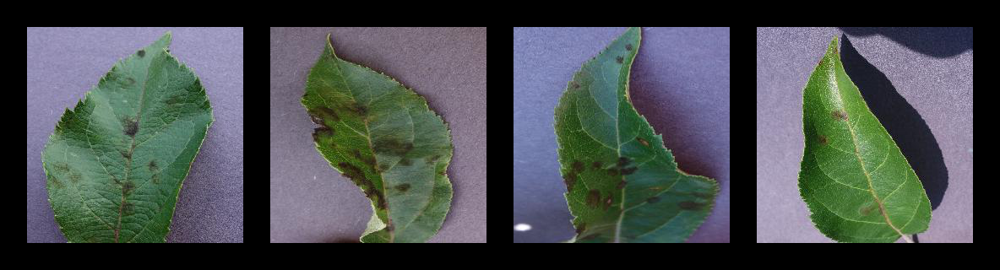

current health category: Apple___Black_rot


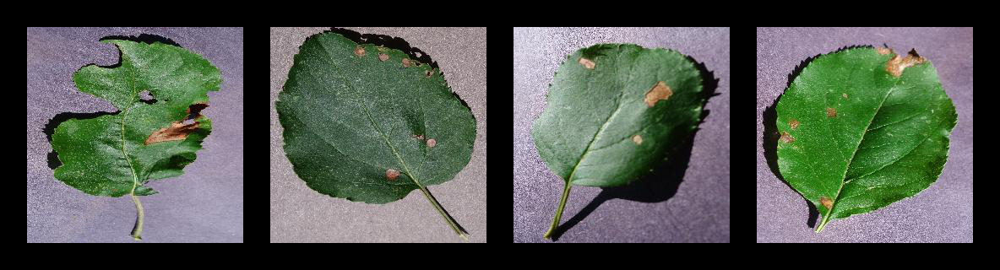

current health category: Apple___Cedar_apple_rust


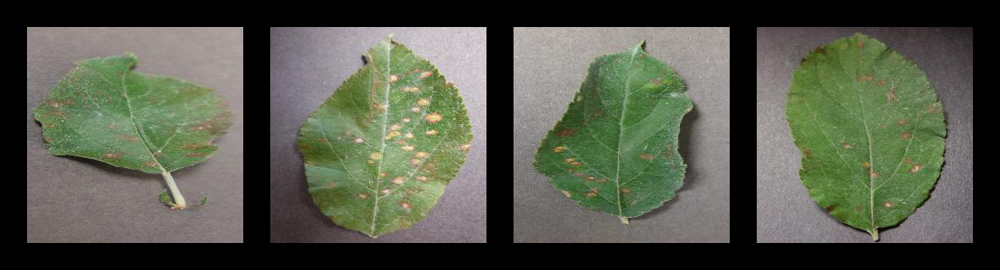

current health category: Apple___healthy


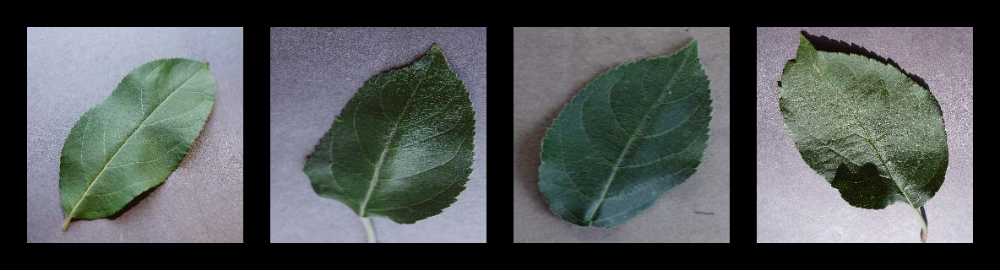

current health category: Blueberry___healthy


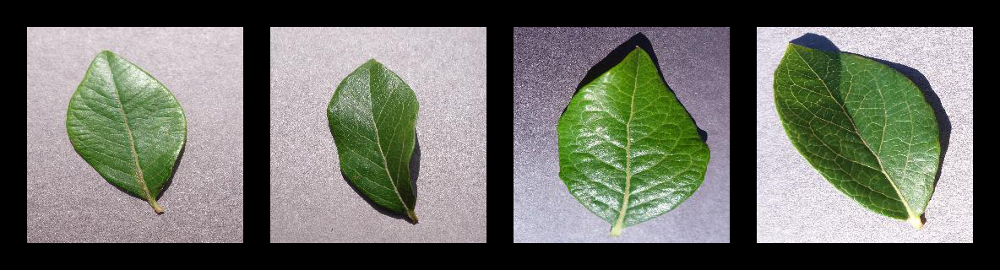

current health category: Cherry_(including_sour)___Powdery_mildew


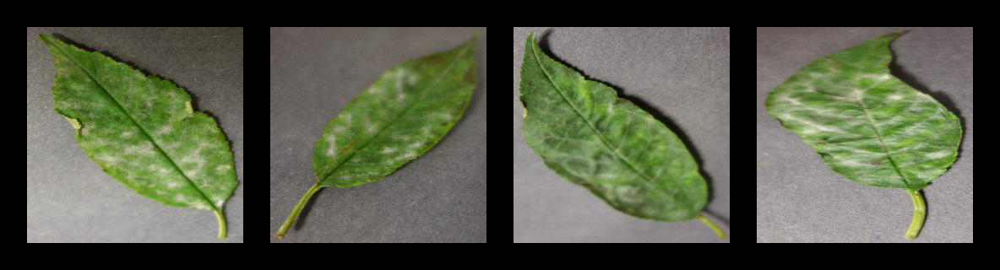

current health category: Cherry_(including_sour)___healthy


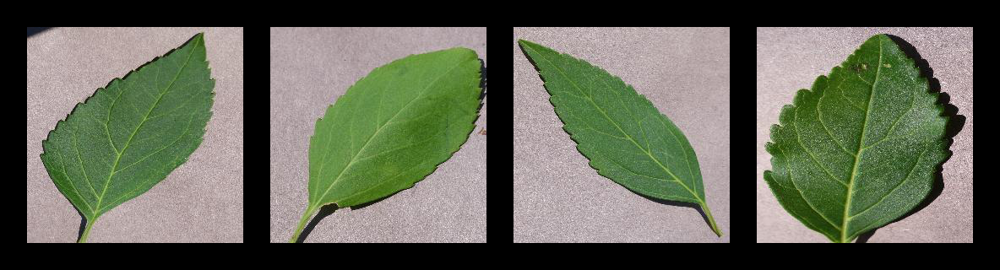

current health category: Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot


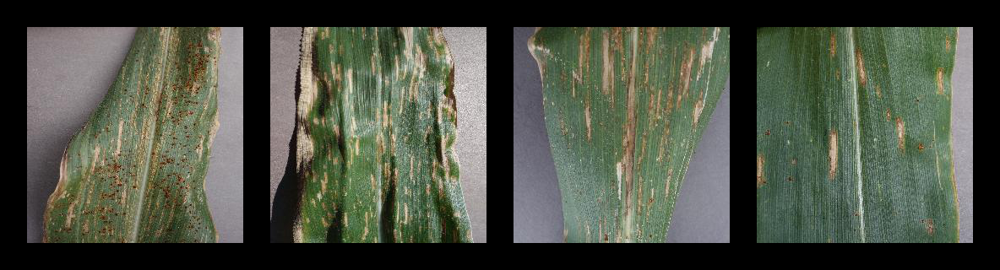

current health category: Corn_(maize)___Common_rust_


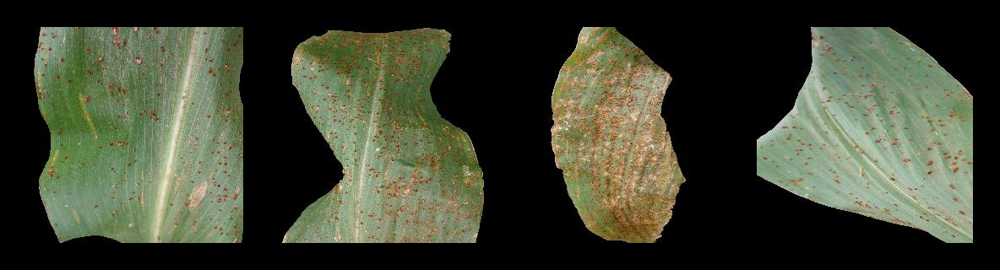

current health category: Corn_(maize)___Northern_Leaf_Blight


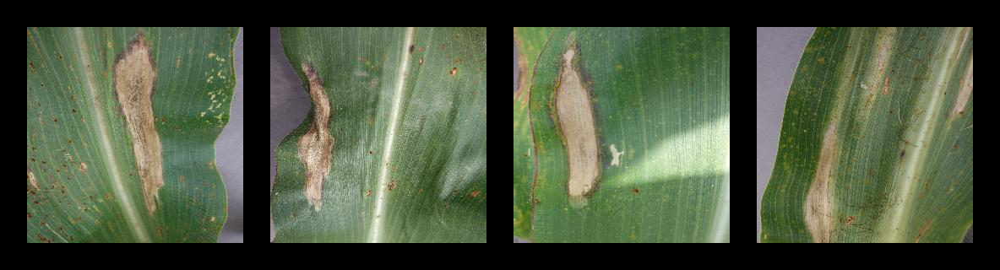

current health category: Corn_(maize)___healthy


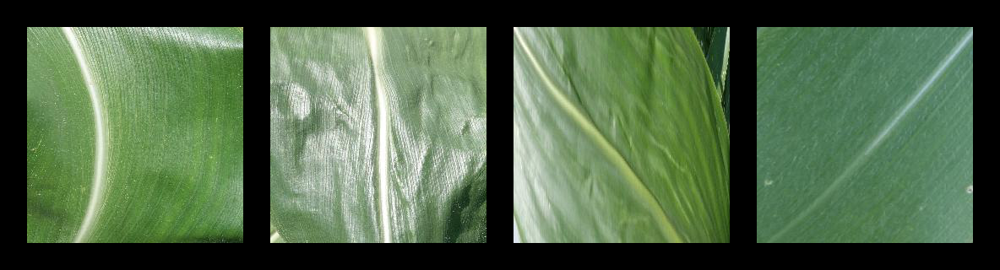

current health category: Grape___Black_rot


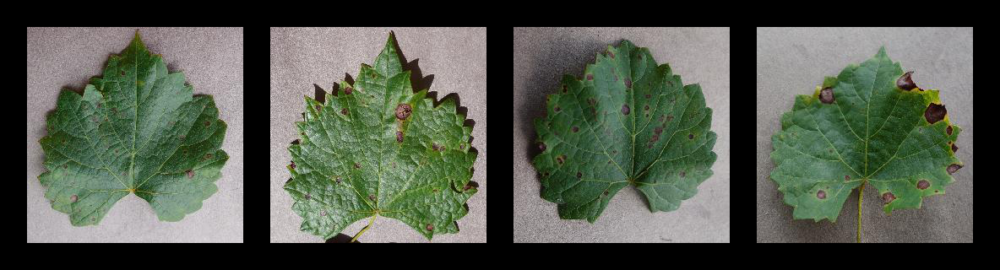

current health category: Grape___Esca_(Black_Measles)


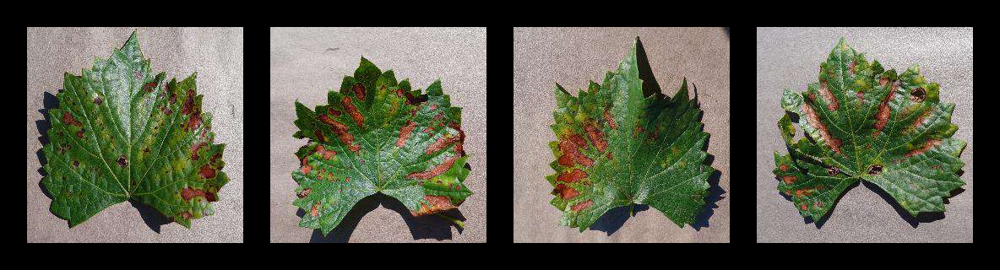

current health category: Grape___Leaf_blight_(Isariopsis_Leaf_Spot)


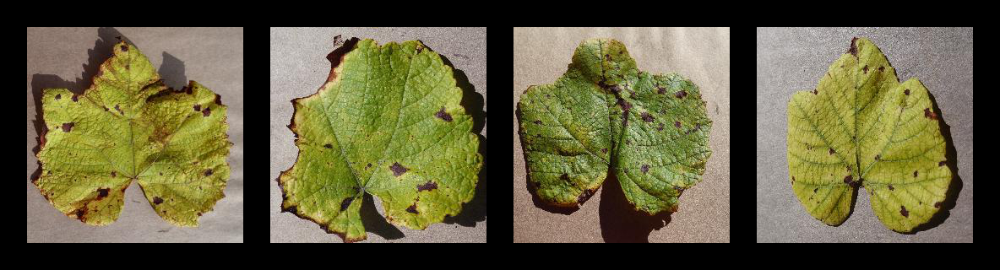

current health category: Grape___healthy


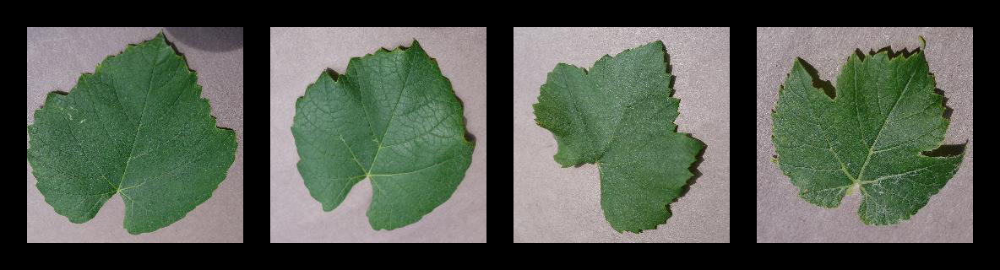

current health category: Orange___Haunglongbing_(Citrus_greening)


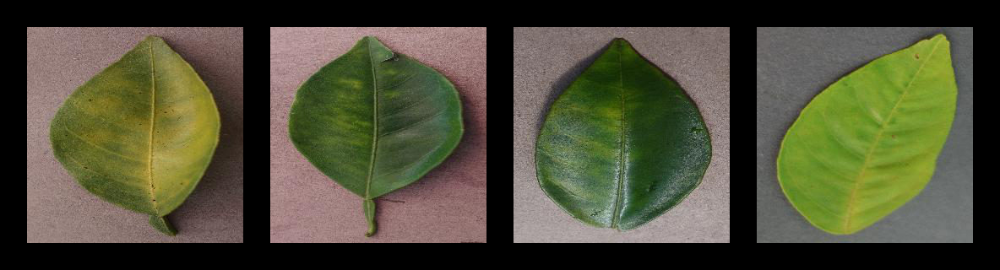

current health category: Peach___Bacterial_spot


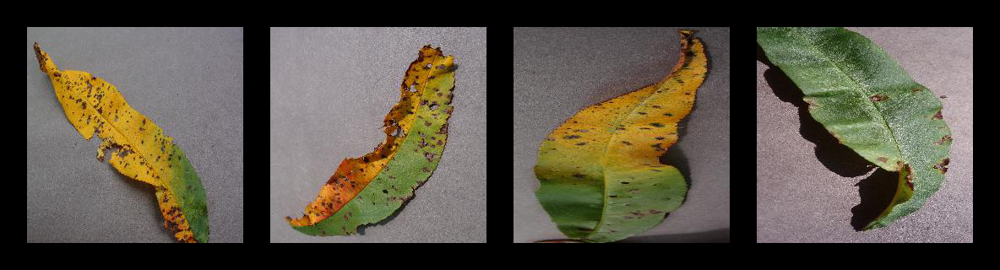

current health category: Peach___healthy


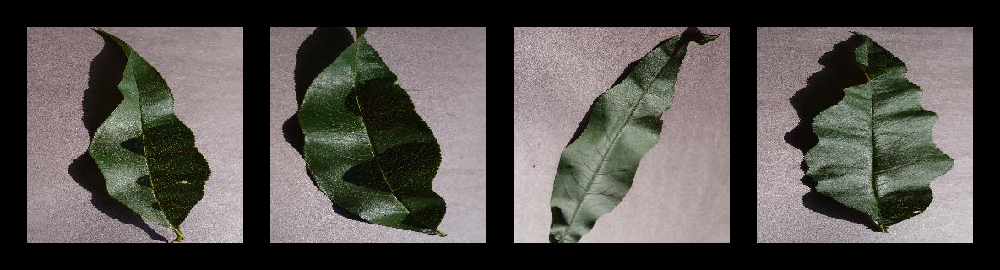

current health category: Pepper,_bell___Bacterial_spot


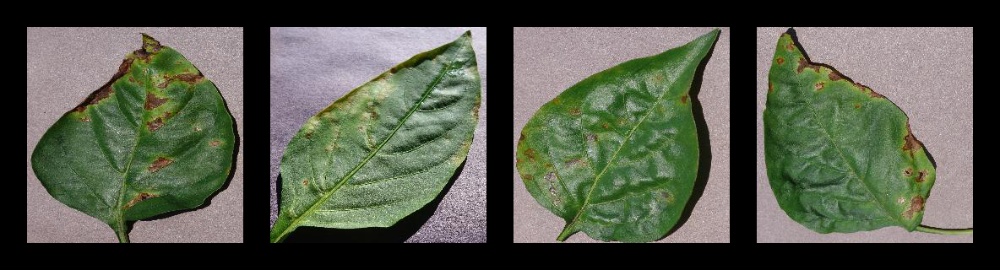

current health category: Pepper,_bell___healthy


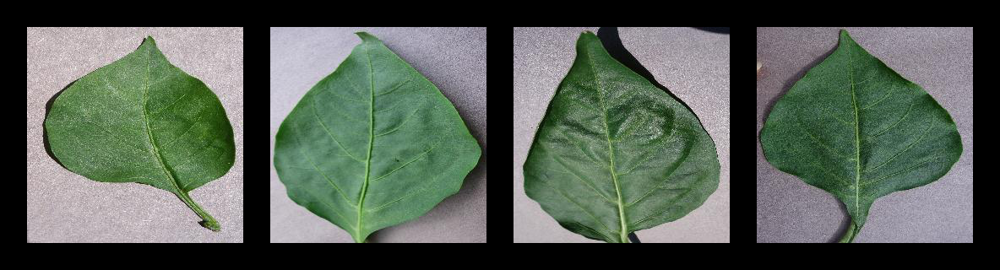

current health category: Potato___Early_blight


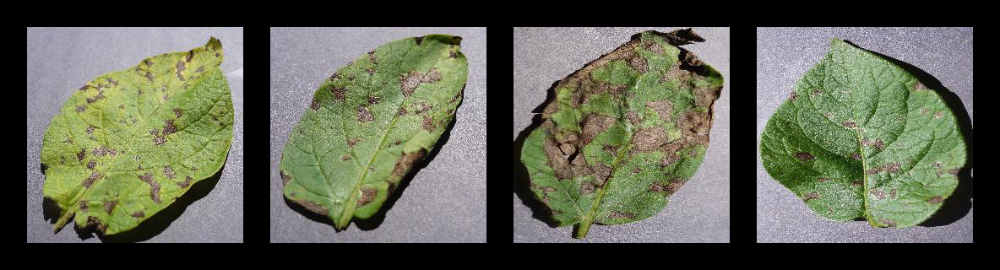

current health category: Potato___Late_blight


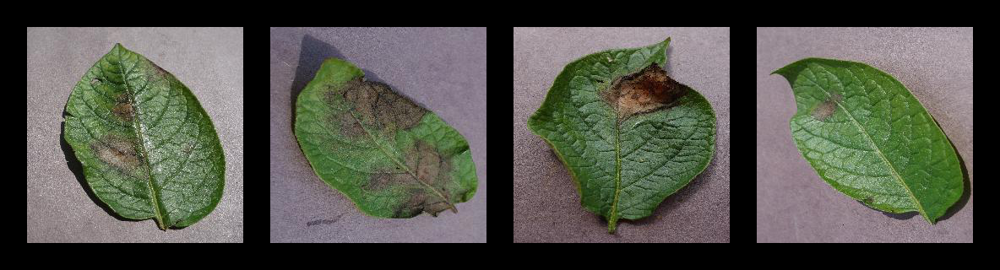

current health category: Potato___healthy


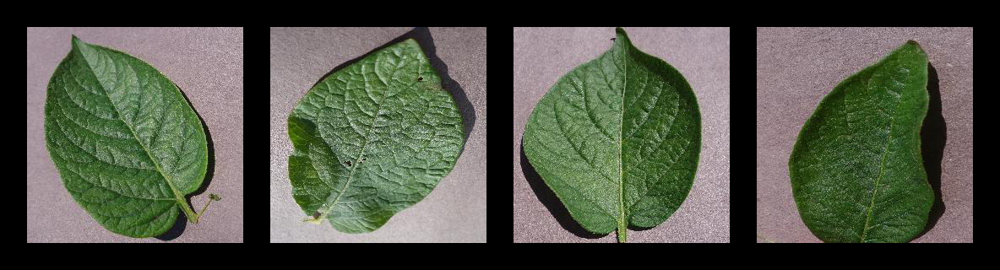

current health category: Raspberry___healthy


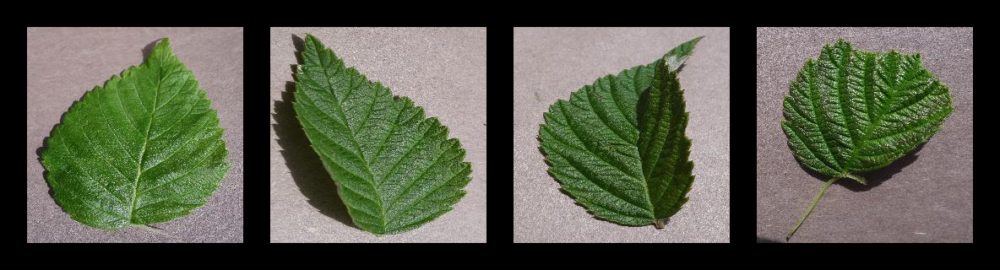

current health category: Soybean___healthy


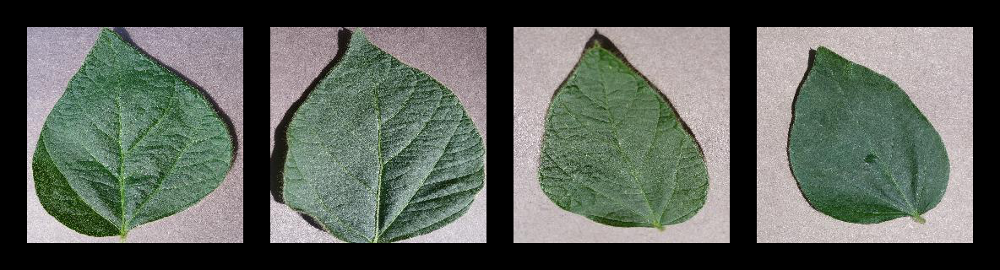

current health category: Squash___Powdery_mildew


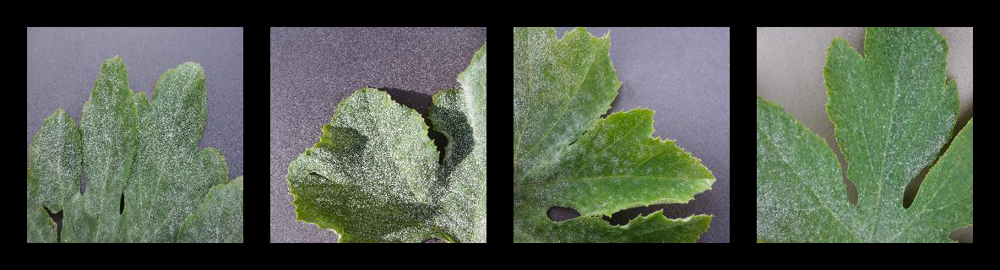

current health category: Strawberry___Leaf_scorch


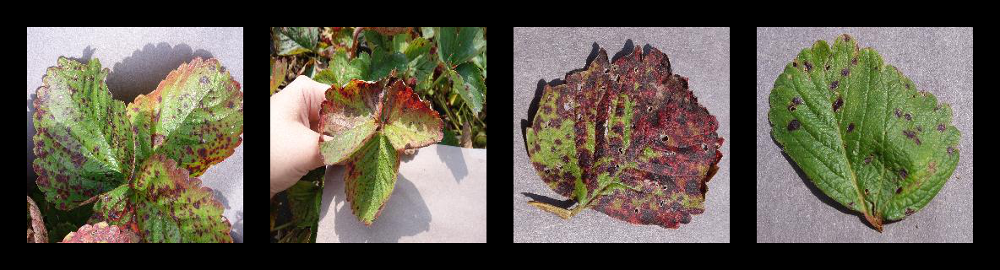

current health category: Strawberry___healthy


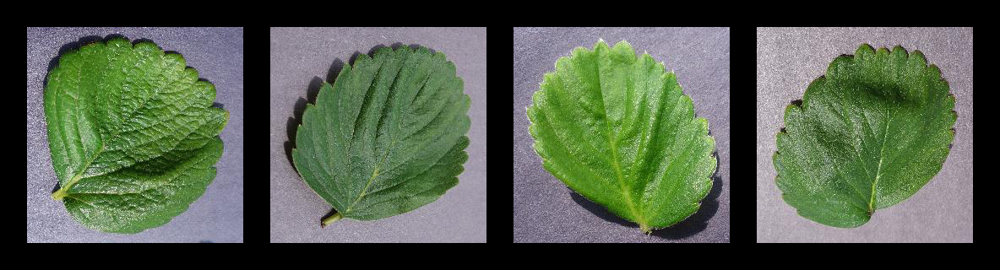

current health category: Tomato___Bacterial_spot


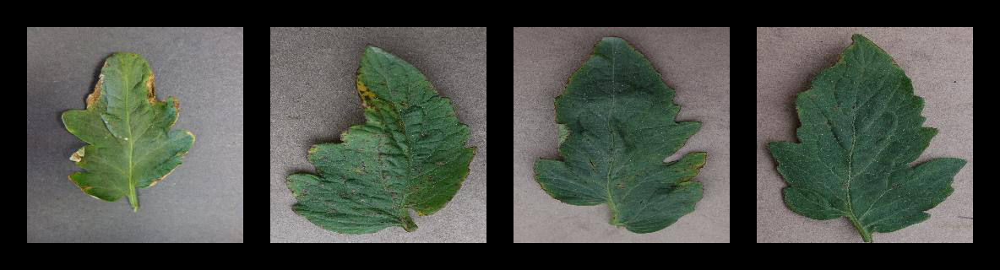

current health category: Tomato___Early_blight


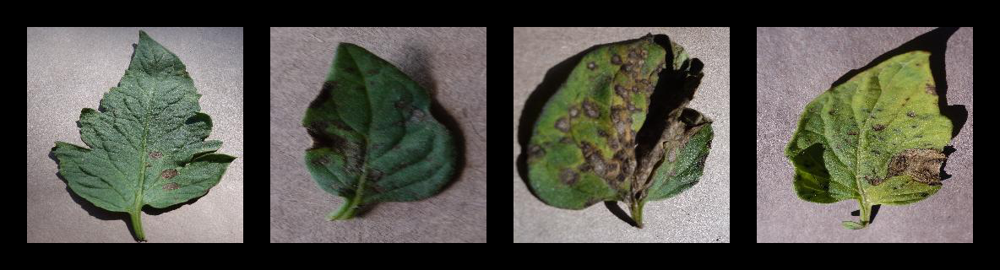

current health category: Tomato___Late_blight


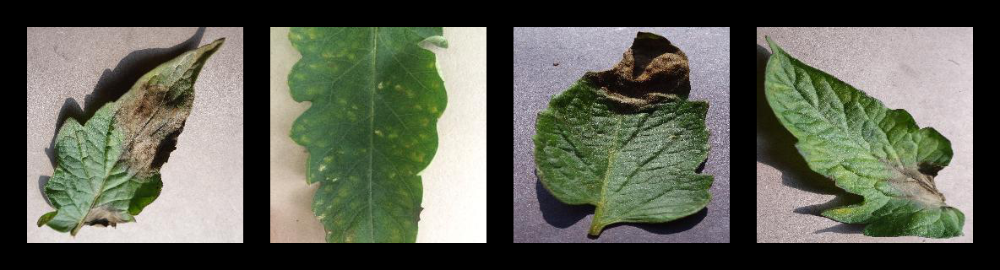

current health category: Tomato___Leaf_Mold


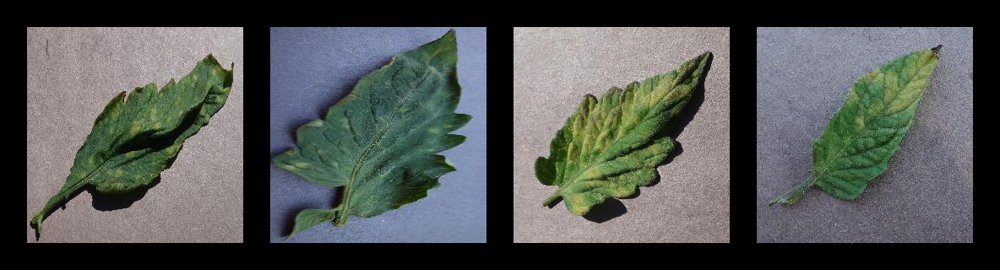

current health category: Tomato___Septoria_leaf_spot


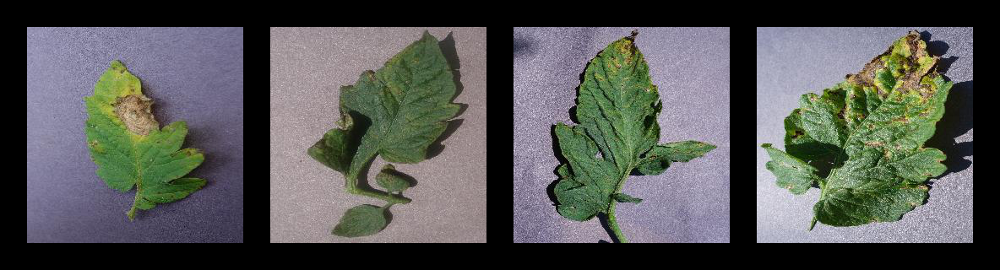

current health category: Tomato___Spider_mites Two-spotted_spider_mite


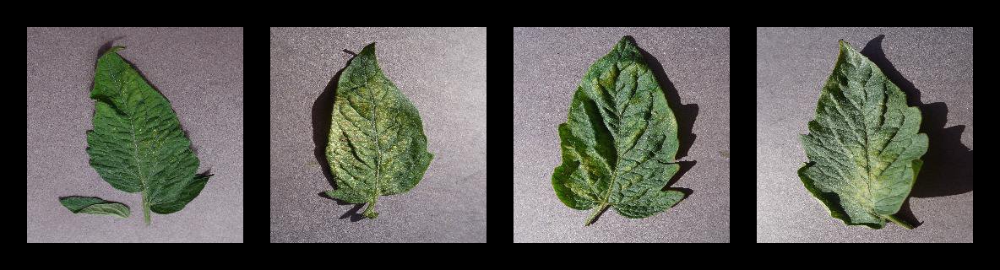

current health category: Tomato___Target_Spot


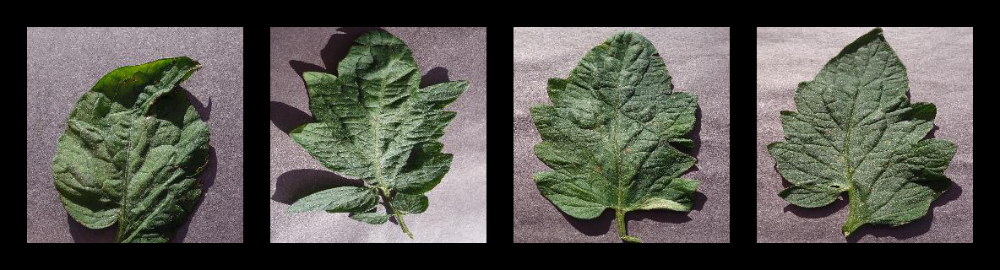

current health category: Tomato___Tomato_Yellow_Leaf_Curl_Virus


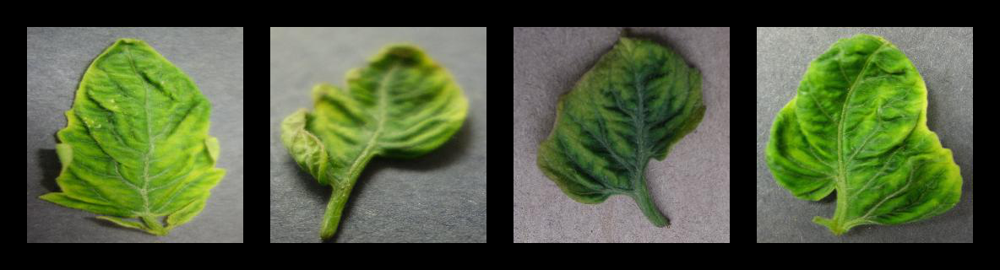

current health category: Tomato___Tomato_mosaic_virus


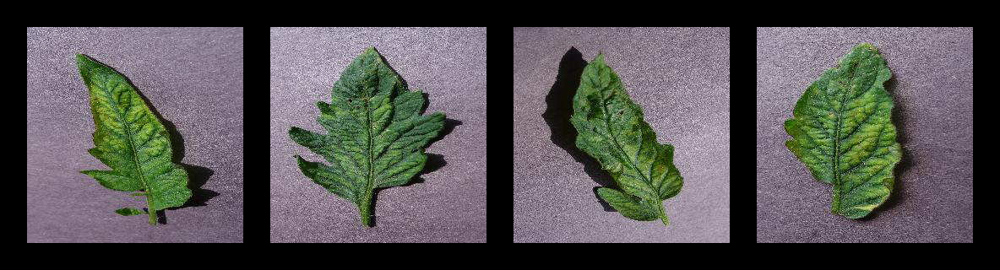

current health category: Tomato___healthy


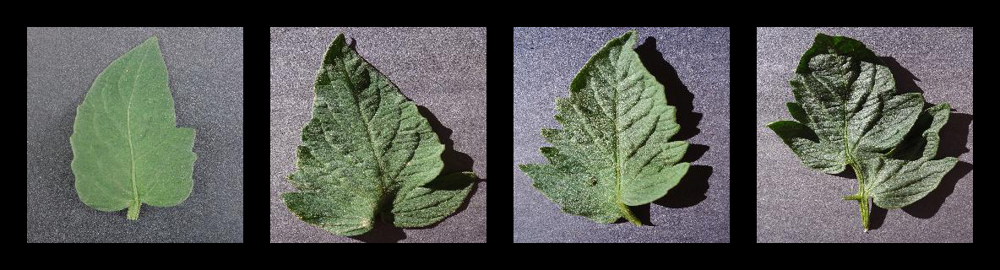

In [15]:
display_sample_imgs('Unzipped_plant_health_data/color/')

we are going to break the overall dataset into 3 sets. Training (80%), validation (10%) and testing (10%) approximately. In each of these folders, create folders for all the plant health categories

In [0]:
assessment_dirs = ['TRAIN', 'TEST', 'VAL']
for cur_dir in assessment_dirs:
  os.mkdir(cur_dir)
  for cur_health_category in plant_health_categories:
    os.mkdir(cur_dir + '/' + cur_health_category)

In [0]:
def move_files(base_src, base_dst, steps=1):
  for cur_health_category in plant_health_categories:
    print('current health', cur_health_category)
    cur_imgs = os.listdir(base_src + '/' + cur_health_category)
    num_of_imgs = len(cur_imgs)
    print('number of images', num_of_imgs)
    for i in range(0, num_of_imgs, steps):
      cur_img = cur_imgs[i]
      src = base_src + '/' + cur_health_category + '/' + cur_img
      dst = base_dst + '/' + cur_health_category + '/' + cur_img
      shutil.move(src, dst)

In [18]:
move_files('Unzipped_plant_health_data/color', 'TEST', 10)

current health Apple___Apple_scab
number of images 630
current health Apple___Black_rot
number of images 621
current health Apple___Cedar_apple_rust
number of images 275
current health Apple___healthy
number of images 1645
current health Blueberry___healthy
number of images 1502
current health Cherry_(including_sour)___Powdery_mildew
number of images 1052
current health Cherry_(including_sour)___healthy
number of images 854
current health Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
number of images 513
current health Corn_(maize)___Common_rust_
number of images 1192
current health Corn_(maize)___Northern_Leaf_Blight
number of images 985
current health Corn_(maize)___healthy
number of images 1162
current health Grape___Black_rot
number of images 1180
current health Grape___Esca_(Black_Measles)
number of images 1383
current health Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
number of images 1076
current health Grape___healthy
number of images 423
current health Orange___Haunglongbi

In [19]:
move_files('Unzipped_plant_health_data/color', 'VAL', 9)

current health Apple___Apple_scab
number of images 567
current health Apple___Black_rot
number of images 558
current health Apple___Cedar_apple_rust
number of images 247
current health Apple___healthy
number of images 1480
current health Blueberry___healthy
number of images 1351
current health Cherry_(including_sour)___Powdery_mildew
number of images 946
current health Cherry_(including_sour)___healthy
number of images 768
current health Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
number of images 461
current health Corn_(maize)___Common_rust_
number of images 1072
current health Corn_(maize)___Northern_Leaf_Blight
number of images 886
current health Corn_(maize)___healthy
number of images 1045
current health Grape___Black_rot
number of images 1062
current health Grape___Esca_(Black_Measles)
number of images 1244
current health Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
number of images 968
current health Grape___healthy
number of images 380
current health Orange___Haunglongbing

In [20]:
move_files('Unzipped_plant_health_data/color', 'TRAIN')

current health Apple___Apple_scab
number of images 504
current health Apple___Black_rot
number of images 496
current health Apple___Cedar_apple_rust
number of images 219
current health Apple___healthy
number of images 1315
current health Blueberry___healthy
number of images 1200
current health Cherry_(including_sour)___Powdery_mildew
number of images 840
current health Cherry_(including_sour)___healthy
number of images 682
current health Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
number of images 409
current health Corn_(maize)___Common_rust_
number of images 952
current health Corn_(maize)___Northern_Leaf_Blight
number of images 787
current health Corn_(maize)___healthy
number of images 928
current health Grape___Black_rot
number of images 944
current health Grape___Esca_(Black_Measles)
number of images 1105
current health Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
number of images 860
current health Grape___healthy
number of images 337
current health Orange___Haunglongbing_(C

Let us check the number of images in each genre in the assessment directories (train, test and val)

In [21]:
for cur_assessment_dir in assessment_dirs:
  print('current assessment directory', cur_assessment_dir)
  for cur_health_category in plant_health_categories:
    print('current health category', cur_health_category)
    print('number of images', len(os.listdir(cur_assessment_dir + '/' + cur_health_category)))
  print('=============================================')

current assessment directory TRAIN
current health category Apple___Apple_scab
number of images 504
current health category Apple___Black_rot
number of images 496
current health category Apple___Cedar_apple_rust
number of images 219
current health category Apple___healthy
number of images 1315
current health category Blueberry___healthy
number of images 1200
current health category Cherry_(including_sour)___Powdery_mildew
number of images 840
current health category Cherry_(including_sour)___healthy
number of images 682
current health category Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
number of images 409
current health category Corn_(maize)___Common_rust_
number of images 952
current health category Corn_(maize)___Northern_Leaf_Blight
number of images 787
current health category Corn_(maize)___healthy
number of images 928
current health category Grape___Black_rot
number of images 944
current health category Grape___Esca_(Black_Measles)
number of images 1105
current health cate

In [22]:
total_train_imgs = 0
total_test_imgs = 0
total_val_imgs = 0
for cur_dir in assessment_dirs:
    for cur_health_category in plant_health_categories:
        num_of_imgs = len(os.listdir(cur_dir + '/' + cur_health_category))
        if cur_dir == 'TRAIN':
            total_train_imgs += num_of_imgs
        elif cur_dir == 'TEST':
            total_test_imgs += num_of_imgs
        else:
            total_val_imgs += num_of_imgs
            
print('total training images', total_train_imgs)
print('total test images', total_test_imgs)
print('total val images', total_val_imgs)

total training images 43413
total test images 5448
total val images 5444


In [0]:
train_dir = 'TRAIN'
val_dir = 'VAL'
test_dir = 'TEST'

In [24]:
batch_size = 128
steps_per_epoch = floor(total_train_imgs/batch_size)
validation_steps = floor(total_val_imgs/batch_size)
test_steps = floor(total_test_imgs/batch_size)
print('steps_per_epoch', steps_per_epoch)
print('validation_steps', validation_steps)
print('test_steps', test_steps)

steps_per_epoch 339
validation_steps 42
test_steps 42


In [0]:
def get_train_datagen():
  return ImageDataGenerator(preprocessing_function=preprocess_input)
  
def get_val_datagen():
  return ImageDataGenerator(preprocessing_function=preprocess_input)
  
def get_test_datagen():
  return ImageDataGenerator(preprocessing_function=preprocess_input)

In [0]:
def handle_model_fit_gen(model, num_epochs, train_generator, validation_generator):
  
  history_data = model.fit_generator(
      train_generator, 
      steps_per_epoch=steps_per_epoch, 
      epochs=num_epochs, 
      validation_data=validation_generator, 
      validation_steps=validation_steps)
  return history_data

In [0]:
def create_line_charts(df, title, xlabel, ylabel):
  ax = sns.lineplot(data=df)
  ax.set(xlabel=xlabel, ylabel=ylabel, title=title)
  
def create_acc_df(history_data, num_epochs):
  epochs_val = list(range(1, num_epochs+1))
  acc_val = history_data.history['acc']
  validation_acc_val = history_data.history['val_acc']
  acc_dict = {
      'epochs':epochs_val,
      'train_acc':acc_val,
      'val_acc':validation_acc_val
  }
  acc_df = pd.DataFrame(acc_dict)
  acc_df.set_index('epochs', inplace=True)
  return acc_df

def create_loss_df(history_data, num_epochs):
  epochs_val = list(range(1, num_epochs+1))
  loss_val = history_data.history['loss']
  validation_loss_val = history_data.history['val_loss']
  loss_dict = {
      'epochs':epochs_val,
      'train_loss':loss_val,
      'val_loss':validation_loss_val
  }
  loss_df = pd.DataFrame(loss_dict)
  loss_df.set_index('epochs', inplace=True)
  return loss_df

In [0]:
def get_MobileNet_Conv_Base(input_shape):
  return MobileNet(weights='imagenet', include_top=False, input_shape=input_shape)

In [0]:
tf.compat.v1.disable_eager_execution()

In [31]:
conv_base1 = get_MobileNet_Conv_Base((224,224,3))










17227776/17225924 [==============================] - 0s 0us/step


In [32]:
conv_base1.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 225, 225, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32

In [33]:
custom_model1 = models.Sequential()
custom_model1.add(conv_base1)
custom_model1.add(layers.Flatten())
custom_model1.add(layers.Dropout(rate=0.3))
custom_model1.add(layers.Dense(512, activation='relu'))
custom_model1.add(layers.Dropout(rate=0.4))
custom_model1.add(layers.Dense(38, activation='softmax'))

Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


In [34]:
print('number of trainable weights before freezing the conv base', len(custom_model1.trainable_weights))
conv_base1.trainable = False
print('number of trainable weights after freezing the conv base', len(custom_model1.trainable_weights))

number of trainable weights before freezing the conv base 85
number of trainable weights after freezing the conv base 4


In [35]:
custom_model1.compile(loss='categorical_crossentropy', optimizer=optimizers.Adam(lr=2e-5), metrics=['accuracy'])

In [36]:
train_datagen1 = get_train_datagen()
validation_datagen1 = get_val_datagen()
test_datagen1 = get_test_datagen()

train_generator1 = train_datagen1.flow_from_directory(train_dir, target_size=(224,224), batch_size=batch_size, class_mode='categorical')
validation_generator1 = validation_datagen1.flow_from_directory(val_dir, target_size=(224,224), batch_size=batch_size, class_mode='categorical')

Found 43413 images belonging to 38 classes.
Found 5444 images belonging to 38 classes.


In [37]:
train_generator1.class_indices

{'Apple___Apple_scab': 0,
 'Apple___Black_rot': 1,
 'Apple___Cedar_apple_rust': 2,
 'Apple___healthy': 3,
 'Blueberry___healthy': 4,
 'Cherry_(including_sour)___Powdery_mildew': 5,
 'Cherry_(including_sour)___healthy': 6,
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 7,
 'Corn_(maize)___Common_rust_': 8,
 'Corn_(maize)___Northern_Leaf_Blight': 9,
 'Corn_(maize)___healthy': 10,
 'Grape___Black_rot': 11,
 'Grape___Esca_(Black_Measles)': 12,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13,
 'Grape___healthy': 14,
 'Orange___Haunglongbing_(Citrus_greening)': 15,
 'Peach___Bacterial_spot': 16,
 'Peach___healthy': 17,
 'Pepper,_bell___Bacterial_spot': 18,
 'Pepper,_bell___healthy': 19,
 'Potato___Early_blight': 20,
 'Potato___Late_blight': 21,
 'Potato___healthy': 22,
 'Raspberry___healthy': 23,
 'Soybean___healthy': 24,
 'Squash___Powdery_mildew': 25,
 'Strawberry___Leaf_scorch': 26,
 'Strawberry___healthy': 27,
 'Tomato___Bacterial_spot': 28,
 'Tomato___Early_blight': 29,
 'Toma

In [38]:
validation_generator1.class_indices

{'Apple___Apple_scab': 0,
 'Apple___Black_rot': 1,
 'Apple___Cedar_apple_rust': 2,
 'Apple___healthy': 3,
 'Blueberry___healthy': 4,
 'Cherry_(including_sour)___Powdery_mildew': 5,
 'Cherry_(including_sour)___healthy': 6,
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 7,
 'Corn_(maize)___Common_rust_': 8,
 'Corn_(maize)___Northern_Leaf_Blight': 9,
 'Corn_(maize)___healthy': 10,
 'Grape___Black_rot': 11,
 'Grape___Esca_(Black_Measles)': 12,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13,
 'Grape___healthy': 14,
 'Orange___Haunglongbing_(Citrus_greening)': 15,
 'Peach___Bacterial_spot': 16,
 'Peach___healthy': 17,
 'Pepper,_bell___Bacterial_spot': 18,
 'Pepper,_bell___healthy': 19,
 'Potato___Early_blight': 20,
 'Potato___Late_blight': 21,
 'Potato___healthy': 22,
 'Raspberry___healthy': 23,
 'Soybean___healthy': 24,
 'Squash___Powdery_mildew': 25,
 'Strawberry___Leaf_scorch': 26,
 'Strawberry___healthy': 27,
 'Tomato___Bacterial_spot': 28,
 'Tomato___Early_blight': 29,
 'Toma

In [39]:
model_history_data1 = handle_model_fit_gen(custom_model1, 25, train_generator1, validation_generator1)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Epoch 1/25
339/339 [==============================] - 106s 314ms/step - loss: 1.3375 - acc: 0.6679 - val_loss: 1.0626 - val_acc: 0.6936
Epoch 2/25
339/339 [==============================] - 100s 296ms/step - loss: 0.3422 - acc: 0.8942 - val_loss: 0.9049 - val_acc: 0.7302
Epoch 3/25
339/339 [==============================] - 100s 295ms/step - loss: 0.1823 - acc: 0.9415 - val_loss: 0.7944 - val_acc: 0.7696
Epoch 4/25
339/339 [==============================] - 99s 293ms/step - loss: 0.1236 - acc: 0.9590 - val_loss: 0.8127 - val_acc: 0.7692
Epoch 5/25
339/339 [==============================] - 95s 282ms/step - loss: 0.0805 - acc: 0.9736 - val_loss: 0.7026 - val_acc: 0.7936
Epoch 6/25
339/339 [==============================] - 95s 282ms/step - loss: 0.0572 - acc: 0.9802 - val_loss: 0.8021 - val_acc: 0.7814
Epoch 7/25
339/339 [==============================] - 96s 282ms/step - loss: 0.0452 - acc: 

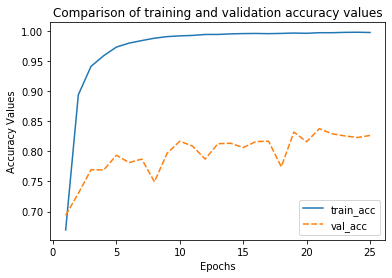

In [40]:
create_line_charts(create_acc_df(model_history_data1, 25), 'Comparison of training and validation accuracy values', 'Epochs', 'Accuracy Values')

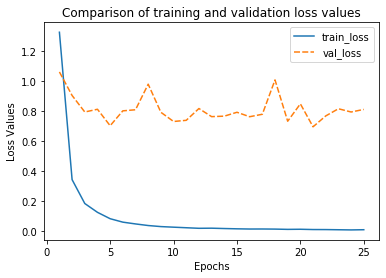

In [41]:
create_line_charts(create_loss_df(model_history_data1, 25), 'Comparison of training and validation loss values', 'Epochs', 'Loss Values')

In [42]:
test_generator1 = test_datagen1.flow_from_directory(test_dir, target_size=(224,224), batch_size=batch_size, class_mode='categorical')
test_loss1, test_accuracy1 = custom_model1.evaluate_generator(test_generator1, steps=test_steps)
print('test_loss', test_loss1)
print('test_accuracy', test_accuracy1)

Found 5448 images belonging to 38 classes.
test_loss 0.8298068117527735
test_accuracy 0.8279389880952381


Since, we are going to use this model in the web, let us save it in a format which is compatible with tensorflowjs

In [0]:
tfjs.converters.save_keras_model(custom_model1, 'drive/My Drive/tfjs_models/plant_health_model1')

Now let us try fine tuning the mobilenet layers to see whether we can improve upon the existing results.

In [0]:
conv_base2 = get_MobileNet_Conv_Base((224,224,3))

In [0]:
def print_layer_details(conv_base):
  for layer in conv_base.layers:
    print('layer name:', layer.name)
    print('layer trainable:', layer.trainable)

In [0]:
def fine_tune_conv_base_block(conv_base, block_name_start):
  trainable = False
  for layer in conv_base.layers:
    if layer.name.startswith(block_name_start):
      trainable = True
    layer.trainable = trainable

In [47]:
print_layer_details(conv_base2)

layer name: input_3
layer trainable: False
layer name: conv1_pad
layer trainable: True
layer name: conv1
layer trainable: True
layer name: conv1_bn
layer trainable: True
layer name: conv1_relu
layer trainable: True
layer name: conv_dw_1
layer trainable: True
layer name: conv_dw_1_bn
layer trainable: True
layer name: conv_dw_1_relu
layer trainable: True
layer name: conv_pw_1
layer trainable: True
layer name: conv_pw_1_bn
layer trainable: True
layer name: conv_pw_1_relu
layer trainable: True
layer name: conv_pad_2
layer trainable: True
layer name: conv_dw_2
layer trainable: True
layer name: conv_dw_2_bn
layer trainable: True
layer name: conv_dw_2_relu
layer trainable: True
layer name: conv_pw_2
layer trainable: True
layer name: conv_pw_2_bn
layer trainable: True
layer name: conv_pw_2_relu
layer trainable: True
layer name: conv_dw_3
layer trainable: True
layer name: conv_dw_3_bn
layer trainable: True
layer name: conv_dw_3_relu
layer trainable: True
layer name: conv_pw_3
layer trainable: T

In [0]:
fine_tune_conv_base_block(conv_base2, 'conv_dw_13')

In [49]:
print_layer_details(conv_base2)

layer name: input_3
layer trainable: False
layer name: conv1_pad
layer trainable: False
layer name: conv1
layer trainable: False
layer name: conv1_bn
layer trainable: False
layer name: conv1_relu
layer trainable: False
layer name: conv_dw_1
layer trainable: False
layer name: conv_dw_1_bn
layer trainable: False
layer name: conv_dw_1_relu
layer trainable: False
layer name: conv_pw_1
layer trainable: False
layer name: conv_pw_1_bn
layer trainable: False
layer name: conv_pw_1_relu
layer trainable: False
layer name: conv_pad_2
layer trainable: False
layer name: conv_dw_2
layer trainable: False
layer name: conv_dw_2_bn
layer trainable: False
layer name: conv_dw_2_relu
layer trainable: False
layer name: conv_pw_2
layer trainable: False
layer name: conv_pw_2_bn
layer trainable: False
layer name: conv_pw_2_relu
layer trainable: False
layer name: conv_dw_3
layer trainable: False
layer name: conv_dw_3_bn
layer trainable: False
layer name: conv_dw_3_relu
layer trainable: False
layer name: conv_pw_

In [0]:
custom_model2 = models.Sequential()
custom_model2.add(conv_base2)
custom_model2.add(layers.Flatten())
custom_model2.add(layers.Dropout(rate=0.3))
custom_model2.add(layers.Dense(512, activation='relu'))
custom_model2.add(layers.Dropout(rate=0.4))
custom_model2.add(layers.Dense(38, activation='softmax'))

In [51]:
custom_model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenet_1.00_224 (Model)   (None, 7, 7, 1024)        3228864   
_________________________________________________________________
flatten_2 (Flatten)          (None, 50176)             0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 50176)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 512)               25690624  
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 38)                19494     
Total params: 28,938,982
Trainable params: 26,772,006
Non-trainable params: 2,166,976
__________________________________

In [52]:
print('number of trainable weights', len(custom_model2.trainable_weights))

number of trainable weights 10


In [53]:
train_datagen2 = get_train_datagen()
validation_datagen2 = get_val_datagen()
test_datagen2 = get_test_datagen()

train_generator2 = train_datagen2.flow_from_directory(train_dir, target_size=(224,224), batch_size=batch_size, class_mode='categorical')
validation_generator2 = validation_datagen2.flow_from_directory(val_dir, target_size=(224,224), batch_size=batch_size, class_mode='categorical')

Found 43413 images belonging to 38 classes.
Found 5444 images belonging to 38 classes.


In [0]:
custom_model2.compile(loss='categorical_crossentropy', optimizer=optimizers.Adam(lr=2e-5), metrics=['accuracy'])

In [55]:
model_history_data2 = handle_model_fit_gen(custom_model2, 20, train_generator2, validation_generator2)

Epoch 1/20
339/339 [==============================] - 99s 291ms/step - loss: 1.2596 - acc: 0.6889 - val_loss: 0.9786 - val_acc: 0.7199
Epoch 2/20
339/339 [==============================] - 100s 295ms/step - loss: 0.3081 - acc: 0.9043 - val_loss: 0.9047 - val_acc: 0.7412
Epoch 3/20
339/339 [==============================] - 101s 299ms/step - loss: 0.1593 - acc: 0.9467 - val_loss: 0.8897 - val_acc: 0.7541
Epoch 4/20
339/339 [==============================] - 98s 289ms/step - loss: 0.1022 - acc: 0.9666 - val_loss: 0.8621 - val_acc: 0.7615
Epoch 5/20
339/339 [==============================] - 100s 294ms/step - loss: 0.0649 - acc: 0.9787 - val_loss: 0.7795 - val_acc: 0.7840
Epoch 6/20
339/339 [==============================] - 98s 288ms/step - loss: 0.0499 - acc: 0.9828 - val_loss: 0.7985 - val_acc: 0.7904
Epoch 7/20
339/339 [==============================] - 97s 285ms/step - loss: 0.0370 - acc: 0.9878 - val_loss: 1.0070 - val_acc: 0.7641
Epoch 8/20
339/339 [==============================] 

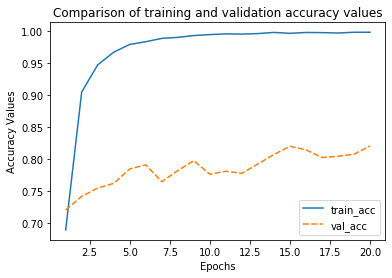

In [56]:
create_line_charts(create_acc_df(model_history_data2, 20), 'Comparison of training and validation accuracy values', 'Epochs', 'Accuracy Values')

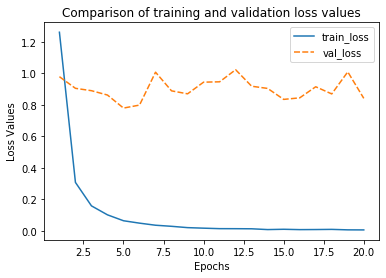

In [57]:
create_line_charts(create_loss_df(model_history_data2, 20), 'Comparison of training and validation loss values', 'Epochs', 'Loss Values')

In [58]:
test_generator2 = test_datagen2.flow_from_directory(test_dir, target_size=(224,224), batch_size=batch_size, class_mode='categorical')
test_loss2, test_accuracy2 = custom_model2.evaluate_generator(test_generator2, steps=test_steps)
print('test_loss', test_loss2)
print('test_accuracy', test_accuracy2)

Found 5448 images belonging to 38 classes.
test_loss 0.9202245005539486
test_accuracy 0.8125


In [0]:
#from google.colab import files

In [0]:
#!zip -r /content/TEST_DOWNLOAD.zip /content/TEST

we can now download the zipped TEST folder, the images in this TEST set will be primarily used to assess the performance of model in the web app